In [2]:
import pandas as pd
import sqlite3
import os

csv_folder = "D:\\graduate\\interview program\\archive (1)" 
db_path = 'my_ecommerce.sqlite'         


conn = sqlite3.connect(db_path)

for file in os.listdir(csv_folder):
    if file.endswith('.csv'):
        table_name = os.path.splitext(file)[0]
        
        df = pd.read_csv(os.path.join(csv_folder, file))
        
        df.to_sql(table_name, conn, if_exists='replace', index=False)
        print(f"成功将 {file} 导入为表: {table_name}")

conn.close()
print("--- 所有数据已成功打包至 .sqlite 文件 ---")

成功将 olist_closed_deals_dataset.csv 导入为表: olist_closed_deals_dataset
成功将 olist_customers_dataset.csv 导入为表: olist_customers_dataset
成功将 olist_geolocation_dataset.csv 导入为表: olist_geolocation_dataset
成功将 olist_marketing_qualified_leads_dataset.csv 导入为表: olist_marketing_qualified_leads_dataset
成功将 olist_orders_dataset.csv 导入为表: olist_orders_dataset
成功将 olist_order_items_dataset.csv 导入为表: olist_order_items_dataset
成功将 olist_order_payments_dataset.csv 导入为表: olist_order_payments_dataset
成功将 olist_order_reviews_dataset.csv 导入为表: olist_order_reviews_dataset
成功将 olist_products_dataset.csv 导入为表: olist_products_dataset
成功将 olist_sellers_dataset.csv 导入为表: olist_sellers_dataset
成功将 product_category_name_translation.csv 导入为表: product_category_name_translation
--- 所有数据已成功打包至 .sqlite 文件 ---


In [3]:
import sqlite3

db_path = 'my_ecommerce.sqlite'
db_connection = sqlite3.connect(db_path)

In [4]:
def view_table(table, limit):
    query = f"""
        SELECT *
        FROM {table}
        LIMIT {limit}
    """
    return pd.read_sql_query(query, db_connection)

# number of orders

In [5]:
view_table('olist_orders_dataset', 5).iloc[:, :3]

,order_id,customer_id,order_status
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered


In [6]:
view_table('olist_orders_dataset', 5).iloc[:, 3:]

,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [7]:
order_per_day = """
SELECT
    DATE(order_purchase_timestamp) AS day,
    COUNT(*) AS order_count
FROM olist_orders_dataset
GROUP BY day
ORDER BY day
"""
df = pd.read_sql_query(order_per_day, db_connection)
df.head(5)

,day,order_count
0,2016-09-04,1
1,2016-09-05,1
2,2016-09-13,1
3,2016-09-15,1
4,2016-10-02,1


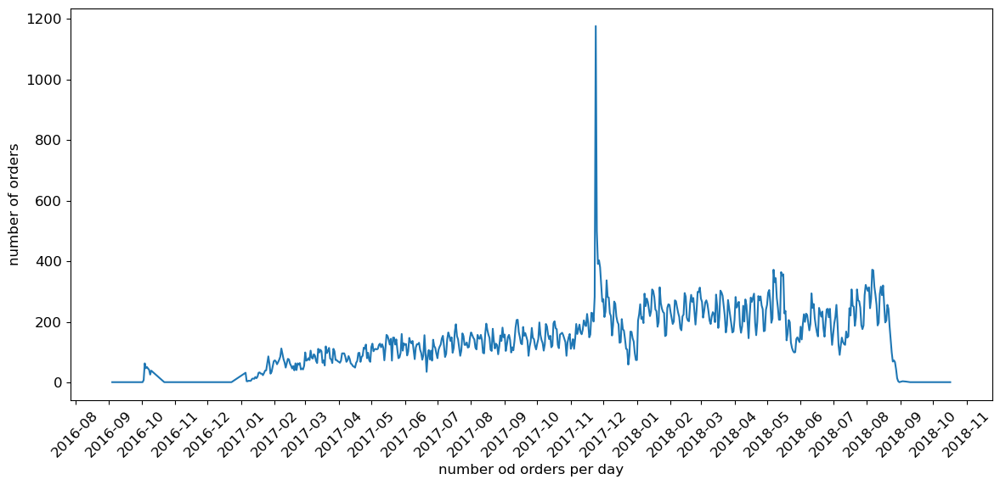

In [8]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

plt.rcParams['font.size']=12
plt.rcParams['axes.titlesize']=16

plt.figure(figsize=(14,6))
plt.plot(pd.to_datetime(df['day']),df['order_count'])
plt.ylabel('number of orders')
plt.xlabel('number od orders per day')
plt.gca().xaxis.set_major_locator(mdates.MonthLocator())
plt.xticks(rotation=45)
plt.show()

In [9]:
order_per_hour = """
SELECT
    CASE strftime('%w', order_purchase_timestamp)
        WHEN '0' THEN 'Sun' WHEN '1' THEN 'Mon' WHEN '2' THEN 'Tue'
        WHEN '3' THEN 'Wed' WHEN '4' THEN 'Thu' WHEN '5' THEN 'Fri' 
        WHEN '6' THEN 'Sat' END as day_of_week_name,
    CAST(strftime('%w', order_purchase_timestamp) AS INT) + 1 as day_of_week_int,
    CAST(strftime('%H', order_purchase_timestamp) AS INT) as hour
FROM olist_orders_dataset
"""

pd.read_sql_query(order_per_hour,db_connection)

,day_of_week_name,day_of_week_int,hour
0,Mon,2,10
1,Tue,3,20
2,Wed,4,8
3,Sat,7,19
4,Tue,3,21
...,...,...,...
99436,Thu,5,9
99437,Tue,3,12
99438,Sun,1,14
99439,Mon,2,21


In [10]:
count_order_per_hour = ',\n '.join([
    f'COUNT(CASE WHEN hour = {i} THEN 1 END) AS "{i}"'\
    for i in range(24)
])

order_per_day_of_the_week_and_hour = f"""
WITH OrderDayHour AS (
{order_per_hour}
)
SELECT 
    day_of_week_name,
    {count_order_per_hour}
FROM OrderDayHour
GROUP BY day_of_week_int
ORDER BY day_of_week_int
"""

In [11]:
df = pd.read_sql_query(order_per_day_of_the_week_and_hour, db_connection)
df = df.set_index('day_of_week_name')
df

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
day_of_week_name,,,,,,,,,,,,,,,,,,,,,
Sun,267,141,69,44,27,27,34,105,205,349,...,684,716,712,797,895,899,967,889,873,607
Mon,328,134,66,36,21,22,69,160,479,783,...,1096,1079,1094,992,928,945,1027,1118,991,717
Tue,306,158,80,28,29,24,71,223,522,864,...,1124,1047,1081,967,877,924,988,1027,965,692
Wed,397,179,81,33,33,27,93,211,517,829,...,1050,983,1040,967,852,848,904,963,878,615
Thu,355,167,75,39,31,28,85,220,502,758,...,977,928,1077,909,784,826,839,840,857,551
Fri,426,216,72,49,40,36,97,206,493,768,...,961,979,974,817,723,784,738,726,702,512
Sat,315,175,67,43,25,24,53,106,249,434,...,677,722,697,701,710,756,730,654,550,429


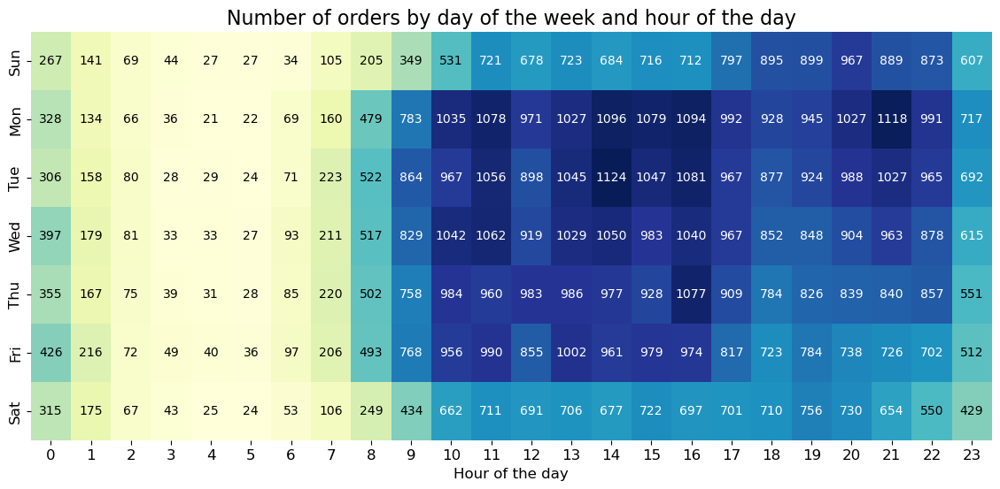

In [12]:
import seaborn as sns
fig, ax = plt.subplots(figsize=(14, 6))
sns.heatmap(df, cmap='YlGnBu', cbar=False)
mean_orders = df.mean().mean()
for i in range(len(df)):
    for j in range(len(df.columns)):
        text_color = 'white' if df.iloc[i, j] > mean_orders else 'black'
        ax.text(j+0.5, i+0.5, int(df.iloc[i, j]),
            color=text_color, fontsize=10, ha="center", va="center")
plt.title("Number of orders by day of the week and hour of the day")
plt.xlabel("Hour of the day")
plt.ylabel("")
plt.show()

In [13]:
view_table('olist_customers_dataset',5)

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


# location

In [14]:
order_per_city= """
SELECT
    customer_city,
    upper(customer_city) as city,
    count(olist_orders_dataset.order_id) as city_order_count
FROM 
    olist_customers_dataset
JOIN olist_orders_dataset 
USING (customer_id)
GROUP BY customer_city
ORDER BY city_order_count DESC
LIMIT 10
""" 
pd.read_sql_query(order_per_city, db_connection)

,customer_city,city,city_order_count
0,sao paulo,SAO PAULO,15540
1,rio de janeiro,RIO DE JANEIRO,6882
2,belo horizonte,BELO HORIZONTE,2773
3,brasilia,BRASILIA,2131
4,curitiba,CURITIBA,1521
5,campinas,CAMPINAS,1444
6,porto alegre,PORTO ALEGRE,1379
7,salvador,SALVADOR,1245
8,guarulhos,GUARULHOS,1189
9,sao bernardo do campo,SAO BERNARDO DO CAMPO,938


In [15]:
order_per_city_reversed = f"""
SELECT *
FROM ({order_per_city})
ORDER BY city_order_count
"""


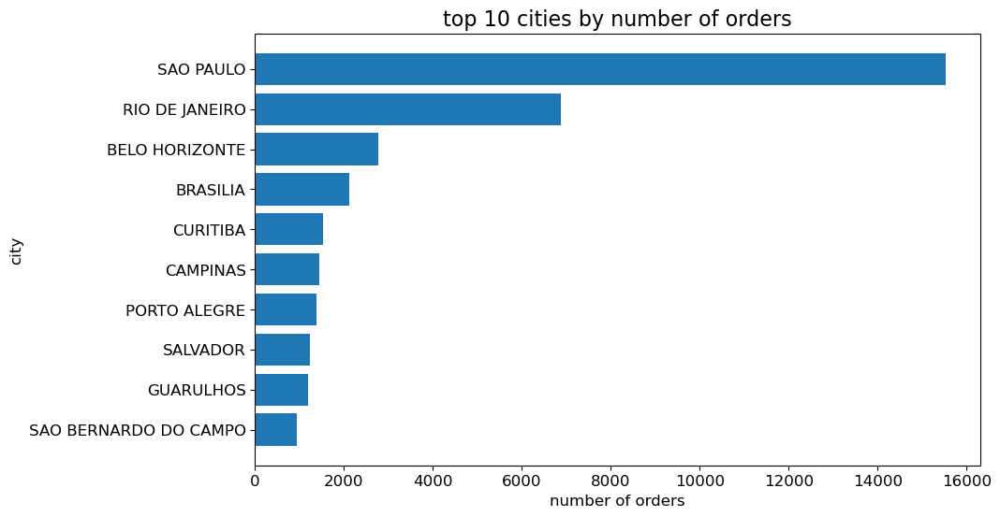

In [16]:
top_cities = pd.read_sql_query(order_per_city_reversed,db_connection)

plt.figure(figsize=(10,6))
plt.barh(top_cities['city'],top_cities['city_order_count'])
plt.xlabel('number of orders')
plt.ylabel('city')
plt.title('top 10 cities by number of orders')
plt.show()

# prices

In [17]:
view_table('olist_order_items_dataset',5).iloc[:, :4]

,order_id,order_item_id,product_id,seller_id
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87


In [18]:
view_table('olist_order_items_dataset',5).iloc[:, 5:]

,price,freight_value
0,58.90,13.29
1,239.90,19.93
2,199.00,17.87
3,12.99,12.79
4,199.90,18.14


In [19]:
order_price_states = """
SELECT
    MIN(order_price) as min_order_price,
    ROUND(AVG(order_price),2) as avg_order_price,
    MAX(order_price) as max_order_price
FROM
 (SELECT

    sum(olist_order_items_dataset.price + olist_order_items_dataset.freight_value) as order_price
FROM olist_order_items_dataset 
GROUP BY olist_order_items_dataset.order_id
) t
"""
pd.read_sql_query(order_price_states,db_connection)

,min_order_price,avg_order_price,max_order_price
0,9.59,160.58,13664.08


In [20]:
order_product_and_shipping_costs = """
SELECT 
    olist_order_items_dataset.order_id,
    SUM(price) as product_cost,
    SUM(freight_value) as shipping_cost
FROM 
    olist_order_items_dataset
JOIN olist_orders_dataset USING (order_id)
WHERE order_status = 'delivered' 
GROUP BY olist_orders_dataset.order_id  
"""
df = pd.read_sql_query(order_product_and_shipping_costs,db_connection)
df

,order_id,product_cost,shipping_cost
0,00010242fe8c5a6d1ba2dd792cb16214,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,199.90,18.14
...,...,...,...
96473,fffc94f6ce00a00581880bf54a75a037,299.99,43.41
96474,fffcd46ef2263f404302a634eb57f7eb,350.00,36.53
96475,fffce4705a9662cd70adb13d4a31832d,99.90,16.95
96476,fffe18544ffabc95dfada21779c9644f,55.99,8.72


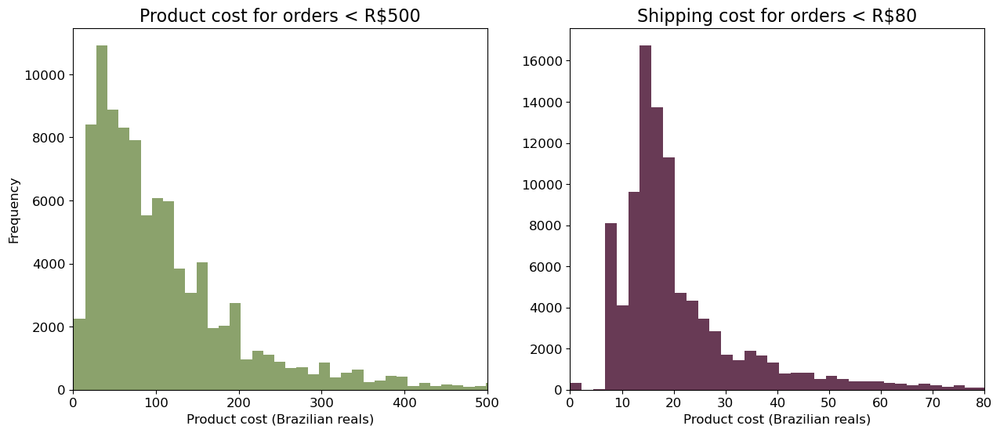

In [21]:
plt.figure(figsize=(15,6))

#product cost
plt.subplot(1, 2, 1)
plt.hist(df['product_cost'], bins=1000, color="#8ba26c")
plt.title('Product cost for orders < R$500')
plt.xlabel('Product cost (Brazilian reals)')
plt.ylabel('Frequency')
plt.xlim([0, 500])
# shipping cost
plt.subplot(1, 2, 2)
plt.hist(df['shipping_cost'], bins=800, color="#683a55")
plt.title('Shipping cost for orders < R$80')
plt.xlabel('Product cost (Brazilian reals)')
plt.xlim([0, 80])
plt.show()


# product categories

In [22]:
view_table('olist_products_dataset',5).iloc[:,[0,1,5]]

,product_id,product_category_name,product_weight_g
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,225.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,1000.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,154.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,371.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,625.0


In [23]:
ranked_categories = """
SELECT
    product_category_name_translation.product_category_name_english as category,
    sum(price) as sales,
    rank() over(order by sum(price) desc) as rank
FROM olist_order_items_dataset
JOIN olist_orders_dataset USING (order_id)
JOIN olist_products_dataset USING (product_id)
JOIN product_category_name_translation USING (product_category_name)
WHERE order_status = 'delivered'
GROUP BY product_category_name_translation.product_category_name_english
"""
df = pd.read_sql_query(ranked_categories,db_connection)
df

,category,sales,rank
0,health_beauty,1233131.72,1
1,watches_gifts,1166176.98,2
2,bed_bath_table,1023434.76,3
3,sports_leisure,954852.55,4
4,computers_accessories,888724.61,5
...,...,...,...
66,flowers,1110.04,67
67,home_comfort_2,760.27,68
68,cds_dvds_musicals,730.00,69
69,fashion_childrens_clothes,519.95,70


In [24]:
category_sales_summary = f"""
WITH ranked_categories as (
{ranked_categories})
SELECT 
    category,
    sales
FROM ranked_categories
WHERE rank <= 18
UNION ALL
SELECT 
    'Other Categories' AS category,
    sum(sales) as sales
FROM ranked_categories
WHERE rank > 18
"""

df = pd.read_sql_query(category_sales_summary, db_connection)
df

,category,sales
0,health_beauty,1233131.72
1,watches_gifts,1166176.98
2,bed_bath_table,1023434.76
3,sports_leisure,954852.55
4,computers_accessories,888724.61
5,furniture_decor,711927.69
6,housewares,615628.69
7,cool_stuff,610204.10
8,auto,578966.65
9,toys,471286.48


In [25]:
%pip install squarify


Note: you may need to restart the kernel to use updated packages.


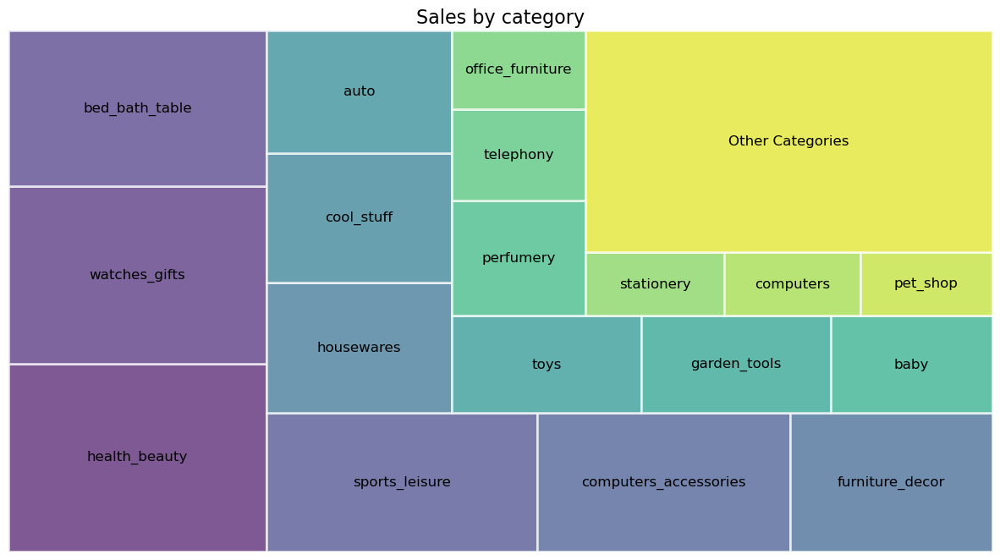

In [26]:
import squarify
plt.figure(figsize=(15, 8))
plt.title('Sales by category')
color = sns.color_palette("viridis", len(df))
squarify.plot(sizes=df['sales'], label=df['category'],
              alpha=0.7, color=color, edgecolor="white", linewidth=2)
plt.axis('off')
plt.show()

In [27]:
top_18_categories = tuple(category for category in df['category'] if category !='Other categories')

In [28]:
top_18_categories

('health_beauty',
 'watches_gifts',
 'bed_bath_table',
 'sports_leisure',
 'computers_accessories',
 'furniture_decor',
 'housewares',
 'cool_stuff',
 'auto',
 'toys',
 'garden_tools',
 'baby',
 'perfumery',
 'telephony',
 'office_furniture',
 'stationery',
 'computers',
 'pet_shop',
 'Other Categories')

In [29]:
ordered_categories = f"""
SELECT
    product_weight_g as weight,
    product_category_name_english as category,
    row_number() over(partition by product_category_name_english order by product_weight_g)
    as category_row_n,
    COUNT(*) OVER(PARTITION BY product_category_name_english) as category_count
FROM olist_products_dataset
JOIN olist_order_items_dataset USING(product_id)
JOIN product_category_name_translation USING(product_category_name)
WHERE product_category_name_english IN {top_18_categories}

"""

df = pd.read_sql_query(ordered_categories,db_connection)
df

,weight,category,category_row_n,category_count
0,50.0,auto,1,4235
1,50.0,auto,2,4235
2,50.0,auto,3,4235
3,50.0,auto,4,4235
4,50.0,auto,5,4235
...,...,...,...,...
92419,15267.0,watches_gifts,5987,5991
92420,15267.0,watches_gifts,5988,5991
92421,15267.0,watches_gifts,5989,5991
92422,17175.0,watches_gifts,5990,5991


In [30]:
categories_by_median = f"""
WITH OrderCategories as (
{ordered_categories})
SELECT category
FROM OrderCategories
WHERE 
    (category_count % 2 = 1 and category_row_n = (category_count + 1)/2) or
    (category_count % 2 = 0 and category_row_n IN ((category_count / 2), (category_count / 2 + 1)))
GROUP BY category
ORDER BY AVG(weight)
"""

median_df = pd.read_sql_query(categories_by_median,db_connection)
median_df

,category
0,telephony
1,computers_accessories
2,watches_gifts
3,health_beauty
4,perfumery
5,baby
6,sports_leisure
7,toys
8,pet_shop
9,auto


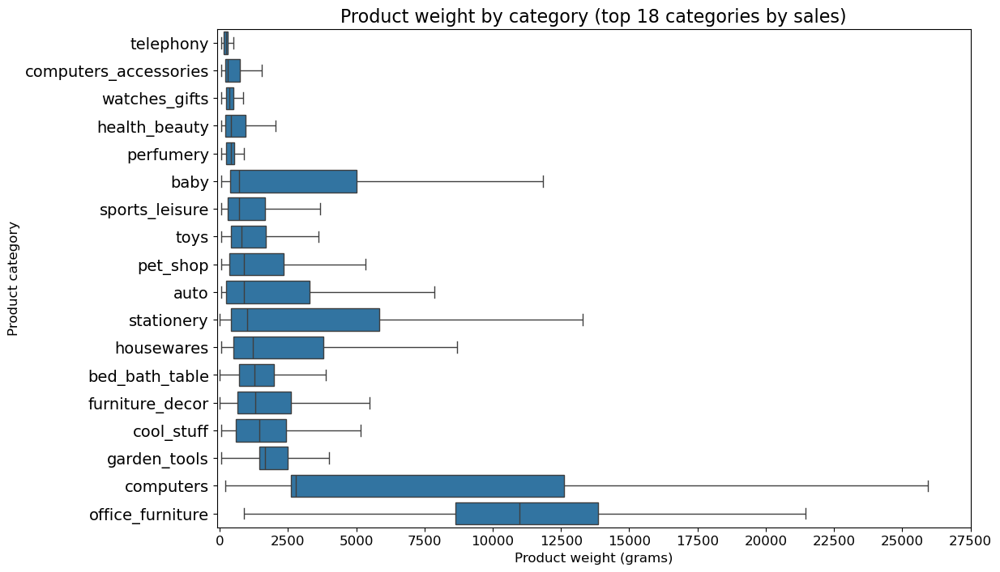

In [31]:
plt.figure(figsize=(12, 8))
order = median_df['category'].tolist()
sns.boxplot(x='weight', y='category', data=df, order=order, showfliers=False)
plt.xlabel('Product weight (grams)')
plt.ylabel('Product category')
plt.title('Product weight by category (top 18 categories by sales)')
plt.xlim(-100, 26100)
plt.xticks(ticks=range(0, 30000, 2500))
plt.yticks(fontsize=14)
plt.show()

# sales trend prediction

In [32]:
selected_categories = ('health_beauty', 'auto', 'toys', 'electronics', 'fashion_shoes')

In [33]:
monthly_sales_selected_categories = f"""
SELECT 
    strftime('%Y-%m', order_purchase_timestamp) as year_month,
    sum(case when product_category_name_english = 'health_beauty' then price end) as healthbeauty,
    sum(case when product_category_name_english = 'auto' then price end ) as auto,
    sum(case when product_category_name_english = 'toys' then price end ) as toys,
    sum(case when product_category_name_english = 'fashion_shoes' then price end) as fasion_shoes
FROM olist_orders_dataset 
JOIN olist_order_items_dataset USING (order_id)
JOIN olist_products_dataset USING (product_id)
JOIN product_category_name_translation USING (product_category_name)
WHERE order_purchase_timestamp >= '2017-01-01'
AND product_category_name_english in {selected_categories}
GROUP BY year_month

"""

df = pd.read_sql_query(monthly_sales_selected_categories, db_connection)
df = df.set_index('year_month')
df

,healthbeauty,auto,toys,fasion_shoes
year_month,,,,
2017-01,12561.32,5218.53,4814.09,34.90
2017-02,22838.79,13162.40,9403.34,107.05
2017-03,25995.25,14482.07,12429.47,1515.00
2017-04,22935.75,15548.17,13039.43,1526.50
2017-05,46786.02,18640.03,22626.95,1669.54
2017-06,32029.39,31370.69,15476.35,1351.20
2017-07,34896.86,14119.74,24511.72,1423.01
2017-08,49873.90,20421.11,18126.87,1491.69
2017-09,51537.65,14544.67,31399.22,1179.60


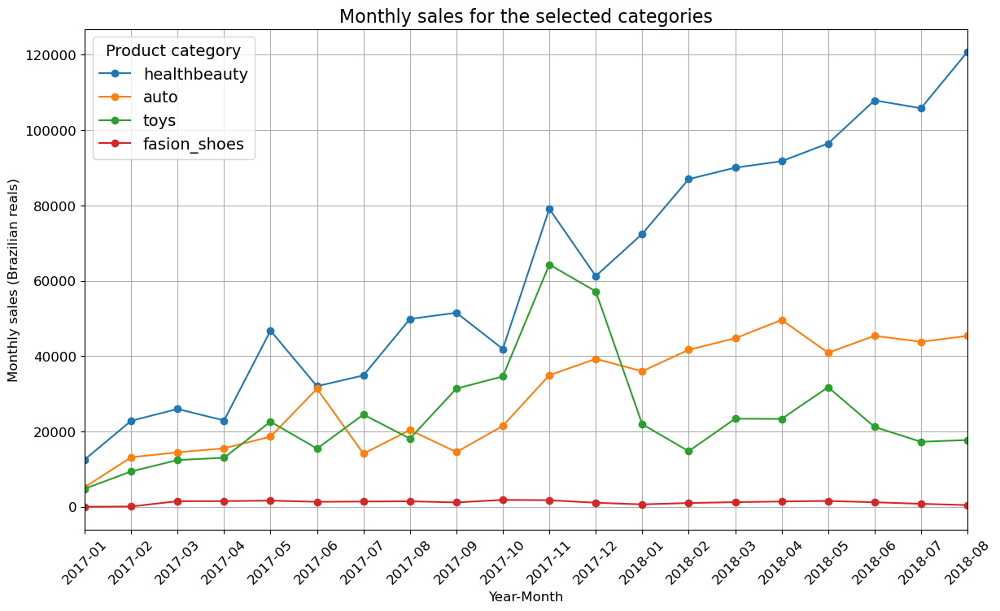

In [34]:
df.index = pd.to_datetime(df.index)
fig, ax = plt.subplots(figsize=(14, 8))
df.plot(ax=ax, marker='o', linestyle='-')
ax.set_xticks(df.index)
ax.set_xticklabels(df.index.strftime('%Y-%m'), rotation=90)
plt.title('Monthly sales for the selected categories')
plt.xlabel('Year-Month')
plt.ylabel('Monthly sales (Brazilian reals)')
plt.xticks(rotation=45)
plt.legend(title='Product category', title_fontsize=14, fontsize=14)
plt.grid(True)
plt.show()

# liner regression

In [35]:
daily_sales_per_category = f"""
SELECT 
    DATE(order_purchase_timestamp) as date,
    cast(julianday(order_purchase_timestamp)-julianday('2017-01-01') as integer) as days,
    product_category_name_english as category,
    sum(price) as sales
FROM 
    olist_orders_dataset
JOIN olist_order_items_dataset USING(order_id)
JOIN olist_products_dataset USING(product_id)
JOIN product_category_name_translation USING(product_category_name)
WHERE order_purchase_timestamp between '2017-01-01' and '2018-08-29' and category in {selected_categories}
GROUP BY days, product_category_name_english
"""

df = pd.read_sql_query(daily_sales_per_category, db_connection)

In [36]:
df

,date,days,category,sales
0,2017-01-05,4,auto,21.80
1,2017-01-05,4,toys,43.80
2,2017-01-06,5,health_beauty,636.00
3,2017-01-06,5,toys,159.99
4,2017-01-07,6,health_beauty,370.00
...,...,...,...,...
2440,2018-08-27,603,auto,343.38
2441,2018-08-27,603,health_beauty,661.50
2442,2018-08-27,603,toys,257.79
2443,2018-08-28,604,auto,124.00


In [37]:
lm_per_category = f"""
WITH DailySalesPerCategory AS (
    {daily_sales_per_category}
)
SELECT 
    category,

    (COUNT(*) * SUM(days * sales) - SUM(days) * SUM(sales)) / 
    (COUNT(*) * SUM(days * days) - SUM(days) * SUM(days)) 
    AS slope,  

    (SUM(sales) - ((COUNT(*) * SUM(days * sales) - SUM(days) * SUM(sales)) / 
    (COUNT(*) * SUM(days * days) - SUM(days) * SUM(days))) * SUM(days)) / COUNT(*) 
    AS intercept
FROM 
    DailySalesPerCategory 
GROUP BY 
    category
"""

df = pd.read_sql_query(lm_per_category, db_connection)
df

,category,slope,intercept
0,auto,2.257831,319.055318
1,electronics,0.614535,105.302974
2,fashion_shoes,0.126815,89.637179
3,health_beauty,5.876734,305.451543
4,toys,0.563910,649.648518


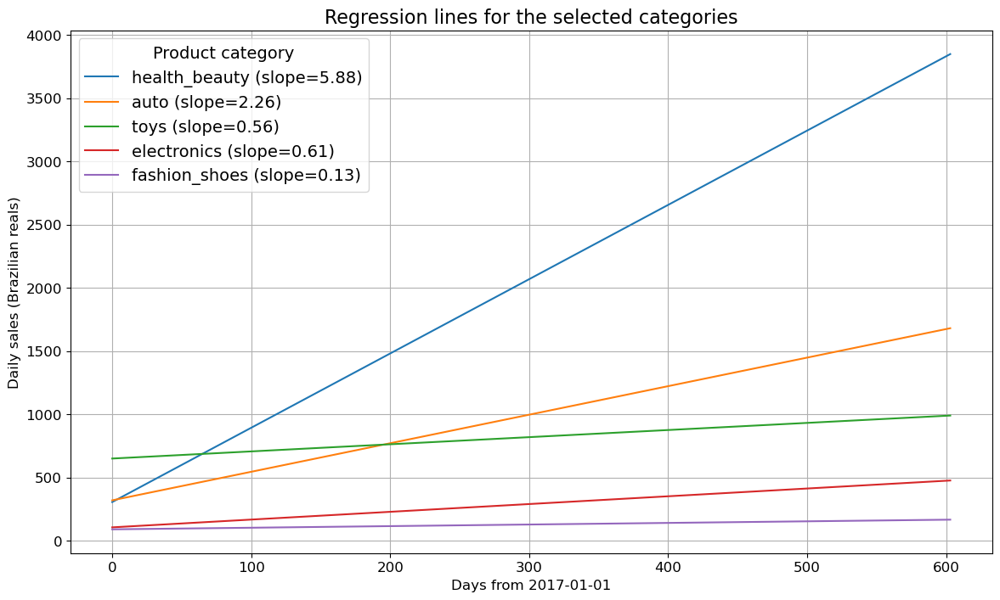

In [38]:
import numpy as np

plt.figure(figsize=(14, 8))
days = np.arange(0, 604)
for category in selected_categories:
    lm = df[df['category'] == category]
    slope = lm['slope'].values[0]
    intercept = lm['intercept'].values[0]
    line = intercept + slope * days
    plt.plot(days, line, label=f'{category} (slope={slope:.2f})')
plt.title('Regression lines for the selected categories')
plt.xlabel('Days from 2017-01-01')
plt.ylabel('Daily sales (Brazilian reals)')
plt.legend(title='Product category', title_fontsize=14, fontsize=14)
plt.grid(True)
plt.show()

In [39]:
forcasted_sales_dec_2018 = f"""
WITH DailySalesPerCategory AS (
{daily_sales_per_category}),
LmPerCategory as ({
    lm_per_category
}),
ForecastedSales as (
    SELECT 
        DATE(date, '+1 year') as date,
        category,
        (intercept + slope * (days + CAST(JULIANDAY('2018-12-31') - JULIANDAY('2017-12-31') AS INTEGER)))
            / (intercept + slope * days) * sales
            AS forecasted_sales
    FROM DailySalesPerCategory
    JOIN LmPerCategory USING (category)
    WHERE days + CAST(JULIANDAY('2018-12-31') - JULIANDAY('2017-12-31') AS INTEGER)
        BETWEEN CAST(JULIANDAY('2018-12-01') - JULIANDAY('2017-01-01') AS INTEGER)
        AND CAST(JULIANDAY('2018-12-31') - JULIANDAY('2017-01-01') AS INTEGER)
)
SELECT 
    CAST(strftime('%d', date) as integer) as december_2018_day,
    category,
    AVG(forecasted_sales) OVER (PARTITION BY category ORDER BY date ROWS BETWEEN 2 PRECEDING AND 2 FOLLOWING)
    as moving_avg_sales
FROM ForecastedSales
"""
forecast_2018_12_df = pd.read_sql_query(forcasted_sales_dec_2018,db_connection)
forecast_2018_12_df

,december_2018_day,category,moving_avg_sales
0,1,auto,2438.257278
1,2,auto,2957.096207
2,3,auto,2612.112277
3,4,auto,3034.655653
4,5,auto,2919.956942
...,...,...,...
126,27,toys,1247.841517
127,28,toys,857.343323
128,29,toys,585.209963
129,30,toys,621.773116


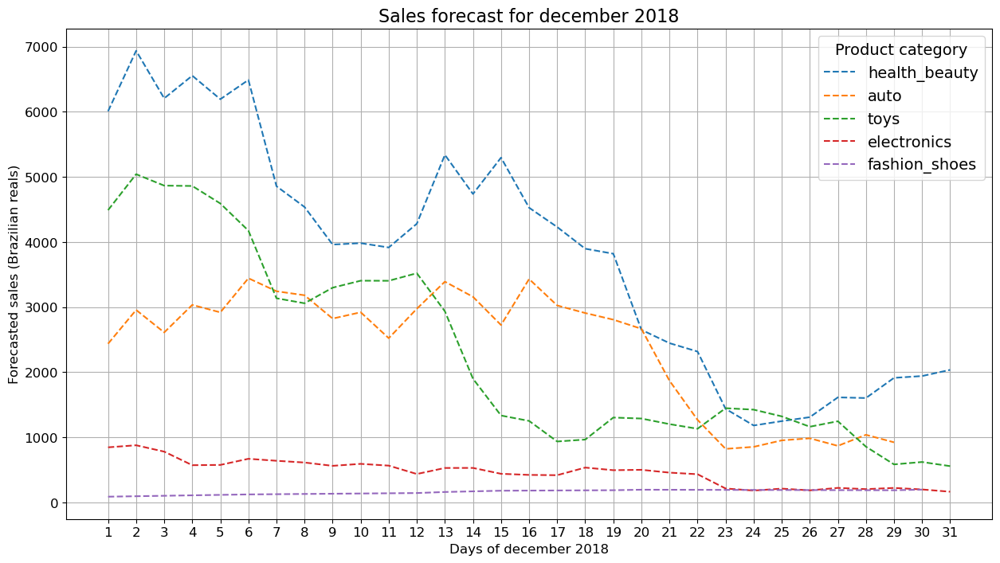

In [40]:
plt.figure(figsize=(15, 8))
for category in selected_categories:
    category_forecast = forecast_2018_12_df[forecast_2018_12_df['category'] == category]
    plt.plot(category_forecast['december_2018_day'], category_forecast['moving_avg_sales'], '--', label=category)
plt.title('Sales forecast for december 2018')
plt.xlabel('Days of december 2018')
plt.ylabel('Forecasted sales (Brazilian reals)')
plt.legend(title='Product category', title_fontsize=14, fontsize=14)
plt.grid(True)
plt.xticks(range(1, 32))
plt.show()

# order delivery

In [41]:
order_stage_times_top_10_citites = f"""
SELECT
    UPPER(customer_city) AS city,
    AVG(JULIANDAY(order_approved_at) - JULIANDAY(order_purchase_timestamp))
        AS approved,
    AVG(JULIANDAY(order_delivered_carrier_date) - JULIANDAY(order_approved_at))
        AS delivered_to_carrier,
    AVG(JULIANDAY(order_delivered_customer_date) - JULIANDAY(order_delivered_carrier_date))
        AS delivered_to_customer,
    AVG(JULIANDAY(order_estimated_delivery_date) - JULIANDAY(order_delivered_customer_date))
        AS estimated_delivery
FROM olist_orders_dataset
JOIN olist_customers_dataset USING (customer_id)
WHERE customer_city IN {tuple(top_cities['customer_city'])}
GROUP BY customer_city
ORDER BY approved + delivered_to_carrier + delivered_to_customer DESC

"""

df = pd.read_sql_query(order_stage_times_top_10_citites,db_connection)
df = df.set_index('city')
df

,approved,delivered_to_carrier,delivered_to_customer,estimated_delivery
city,,,,
SALVADOR,0.498863,2.700868,16.160566,8.755085
PORTO ALEGRE,0.420697,2.809786,12.786769,11.091915
RIO DE JANEIRO,0.383342,2.979133,11.409813,12.504991
BRASILIA,0.432585,2.762064,9.805472,11.333709
BELO HORIZONTE,0.378608,2.848813,7.900486,11.901479
CURITIBA,0.453929,2.690824,7.316206,12.732135
CAMPINAS,0.420262,2.784653,6.611740,8.821432
SAO BERNARDO DO CAMPO,0.349693,2.702651,5.045101,9.799631
SAO PAULO,0.385928,2.726784,4.961921,10.027349


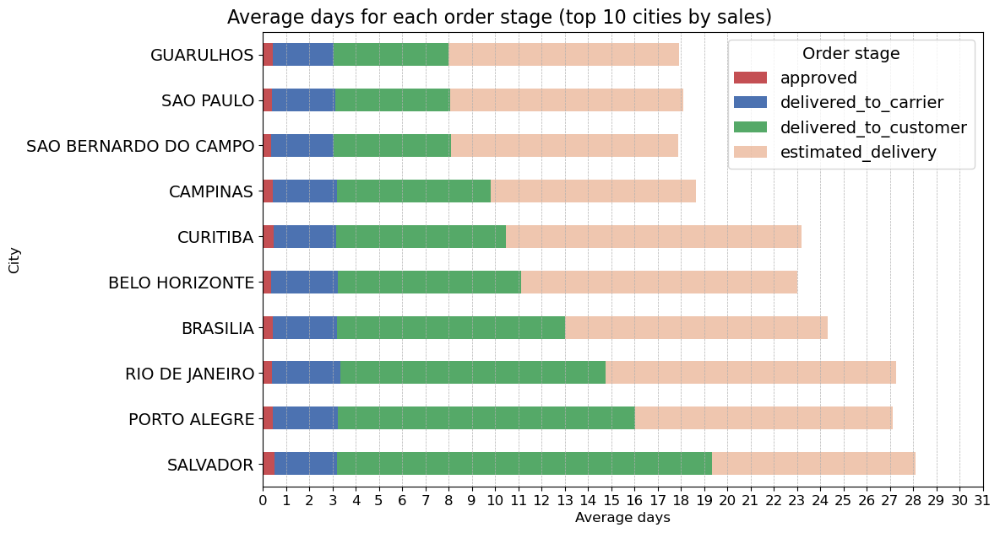

In [42]:
fig, ax = plt.subplots(figsize=(11, 7))
df.plot(kind='barh', stacked=True, color=['#c44f53', '#4c72b1', '#55a968', '#dd845275'], ax=ax)
ax.set_xlabel('Average days')
ax.set_ylabel('City')
fig.suptitle('Average days for each order stage (top 10 cities by sales)', fontsize=16, x=0.38, y=0.92)
ax.grid(True, linestyle='--', linewidth=0.5, axis='x')
max_bar_length = int(df.sum(axis=1).max())
ax.set_xticks(range(0, max_bar_length + 4))
ax.tick_params(axis='y', labelsize=14)
plt.legend(title='Order stage', title_fontsize=14, fontsize=14)
plt.show()

In [43]:
daily_avg_shipping_time = """
SELECT
    DATE(order_purchase_timestamp) as purchase_date,
    AVG(JULIANDAY(order_delivered_customer_date)-JULIANDAY(order_purchase_timestamp)) 
    as avg_delivery_time
FROM olist_orders_dataset
WHERE order_purchase_timestamp >= '2017-06-01' AND order_purchase_timestamp <= '2018-06-30'
GROUP BY DATE(order_purchase_timestamp)
"""

df = pd.read_sql_query(daily_avg_shipping_time, db_connection)
df

,purchase_date,avg_delivery_time
0,2017-06-01,11.238623
1,2017-06-02,12.079623
2,2017-06-03,14.255051
3,2017-06-04,12.064359
4,2017-06-05,11.101563
...,...,...
389,2018-06-25,7.280438
390,2018-06-26,8.173340
391,2018-06-27,8.854751
392,2018-06-28,8.601704


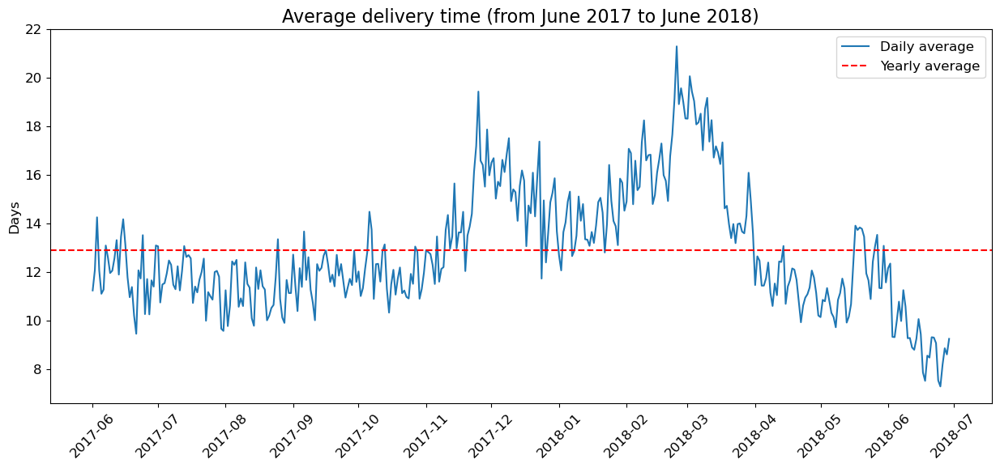

In [44]:
plt.figure(figsize=(15, 6))
plt.plot(pd.to_datetime(df['purchase_date']), df['avg_delivery_time'], label='Daily average')
plt.axhline(y=df['avg_delivery_time'].mean(), color='r', linestyle='--', label='Yearly average')
plt.ylabel('Days')
plt.title('Average delivery time (from June 2017 to June 2018)')
plt.gca().xaxis.set_major_locator(mdates.MonthLocator())
plt.xticks(rotation=45)
plt.legend()
plt.show()


# orrder reviews

In [45]:
view_table('olist_order_reviews_dataset',5).iloc[:,[1,2,4]]

,order_id,review_score,review_comment_message
0,73fc7af87114b39712e6da79b0a377eb,4,None
1,a548910a1c6147796b98fdf73dbeba33,5,None
2,f9e4b658b201a9f2ecdecbb34bed034b,5,None
3,658677c97b385a9be170737859d3511b,5,Recebi bem antes do prazo estipulado.
4,8e6bfb81e283fa7e4f11123a3fb894f1,5,Parabéns lojas lannister adorei comprar pela I...


## count review score

In [46]:
review_score_count = """
SELECT
    review_score,
    COUNT(*) AS count
FROM olist_order_reviews_dataset
GROUP BY review_score
"""
df = pd.read_sql_query(review_score_count,db_connection)
df

,review_score,count
0,1,11424
1,2,3151
2,3,8179
3,4,19142
4,5,57328


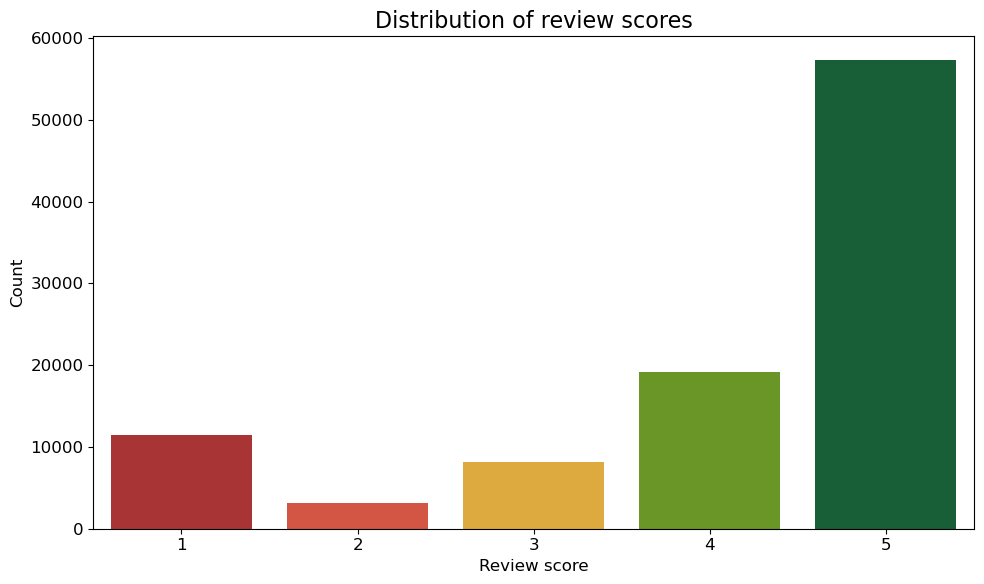

In [47]:
plt.figure(figsize=(10,6))
colors = ['#BC2023', '#EB442C', '#F8B324', '#6da814', '#0C6B37']
sns.barplot(x='review_score', y='count', data=df, hue='review_score', palette=colors, dodge=False)
plt.title('Distribution of review scores')
plt.xlabel('Review score')
plt.ylabel('Count')
plt.legend().remove()
plt.tight_layout()
plt.show()


In [48]:
negative_comments = """
SELECT
    GROUP_CONCAT(review_comment_message, '') as comments
FROM olist_order_reviews_dataset
WHERE review_score IN (1,2)
"""
negative_comments_df = pd.read_sql_query(negative_comments, db_connection)['comments'][0]
negative_comments_df[:150]

'GOSTARIA DE SABER O QUE HOUVE, SEMPRE RECEBI E ESSA COMPRA AGORA ME DECPCIONOUPéssimoNão gostei ! Comprei gato por lebreSempre compro pela Internet e '

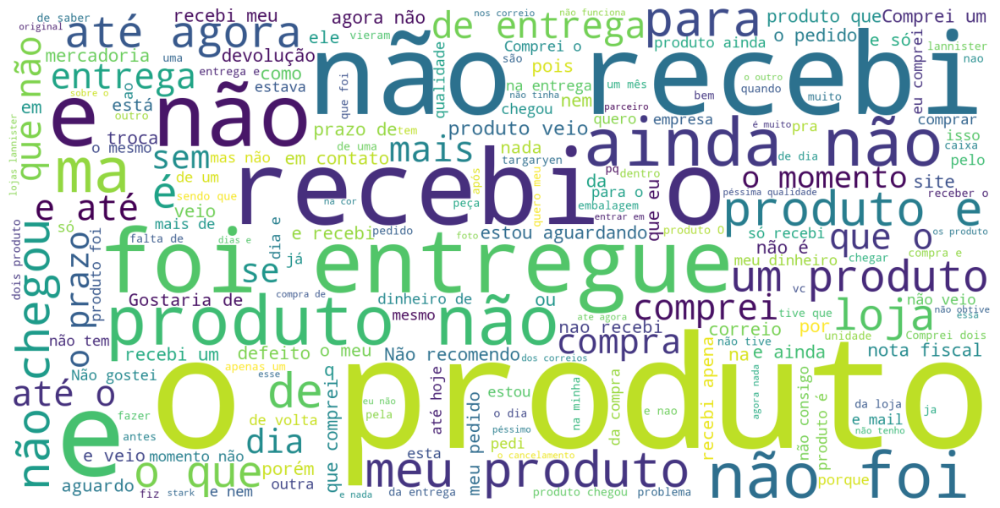

In [49]:
from wordcloud import WordCloud

wordcloud = WordCloud(width=1600, height=800, background_color='white').generate(negative_comments_df)
plt.figure(figsize=(15, 8))
plt.imshow(wordcloud)
plt.axis("off")
plt.show()

# customer segmentation

## RFM客户分层 recency, frequency, montary value

In [50]:
rfm_buckets = """
WITH RecencyScore AS (
    SELECT 
        customer_unique_id,
        MAX(order_purchase_timestamp) AS last_purchase,
        NTILE(5) OVER (ORDER BY MAX(order_purchase_timestamp) DESC) AS recency
    FROM olist_orders_dataset
    JOIN olist_customers_dataset USING (customer_id)
    WHERE order_status = 'delivered'
    GROUP BY customer_unique_id),

FrequencyScore as (
    SELECT 
        customer_unique_id,
        COUNT(order_id) AS total_orders,
        NTILE(5) OVER (ORDER BY COUNT(ORDER_ID) DESC) AS frequency
    FROM olist_orders_dataset
    JOIN olist_customers_dataset USING (customer_id)
    WHERE order_status = 'delivered'
    GROUP BY customer_unique_id
    ),
MonetaryScore AS (
    SELECT
        customer_unique_id,
        sum(price) as total_spent,
        NTILE(5) OVER (ORDER BY SUM(price) DESC) AS monetary
    FROM olist_orders_dataset
    JOIN olist_order_items_dataset USING (order_id)
    JOIN olist_customers_dataset USING (customer_id)
    WHERE order_status = 'delivered'
    GROUP BY customer_unique_id
    ),

RFM AS (
    SELECT 
        last_purchase,
        total_orders,
        total_spent,
        CASE WHEN 
        recency = 1 AND frequency + monetary IN (1, 2, 3, 4) THEN "Champions"
            WHEN recency IN (4, 5) AND frequency + monetary IN (1, 2) THEN "Can't Lose Them"
            WHEN recency IN (4, 5) AND frequency + monetary IN (3, 4, 5, 6) THEN "Hibernating"
            WHEN recency IN (4, 5) AND frequency + monetary IN (7, 8, 9, 10) THEN "Lost"
            WHEN recency IN (2, 3) AND frequency + monetary IN (1, 2, 3, 4) THEN "Loyal Customers"
            WHEN recency = 3 AND frequency + monetary IN (5, 6) THEN "Needs Attention"
            WHEN recency = 1 AND frequency + monetary IN (7, 8) THEN "Recent Users"
            WHEN recency = 1 AND frequency + monetary IN (5, 6) OR
                recency = 2 AND frequency + monetary IN (5, 6, 7, 8) THEN "Potentital Loyalists"
            WHEN recency = 1 AND frequency + monetary IN (9, 10) THEN "Price Sensitive"
            WHEN recency = 2 AND frequency + monetary IN (9, 10) THEN "Promising"
            WHEN recency = 3 AND frequency + monetary IN (7, 8, 9, 10) THEN "About to Sleep"
        END AS RFM_Bucket
    FROM RecencyScore
        JOIN FrequencyScore USING(customer_unique_id)
        JOIN MonetaryScore USING (customer_unique_id))

SELECT
    RFM_Bucket,
    AVG(JULIANDAY('now')- JULIANDAY(last_purchase)) as avg_days_since_purchase,
    AVG(total_spent/total_orders) AS avg_sales_per_customer,
    COUNT(*) AS customer_count
FROM RFM
GROUP BY RFM_Bucket
"""

df = pd.read_sql_query(rfm_buckets,db_connection)
df

,RFM_Bucket,avg_days_since_purchase,avg_sales_per_customer,customer_count
0,About to Sleep,2933.375380,57.684959,7584
1,Can't Lose Them,3106.678689,350.886817,1723
2,Champions,2760.405945,250.856821,4607
3,Hibernating,3107.688366,182.845816,20288
4,Lost,3110.217144,57.393210,15331
5,Loyal Customers,2890.871409,237.881257,9315
6,Needs Attention,2934.432460,145.904925,6510
7,Potentital Loyalists,2817.566577,130.374773,18114
8,Price Sensitive,2759.030541,34.909351,2220
9,Promising,2850.520213,35.085359,2245


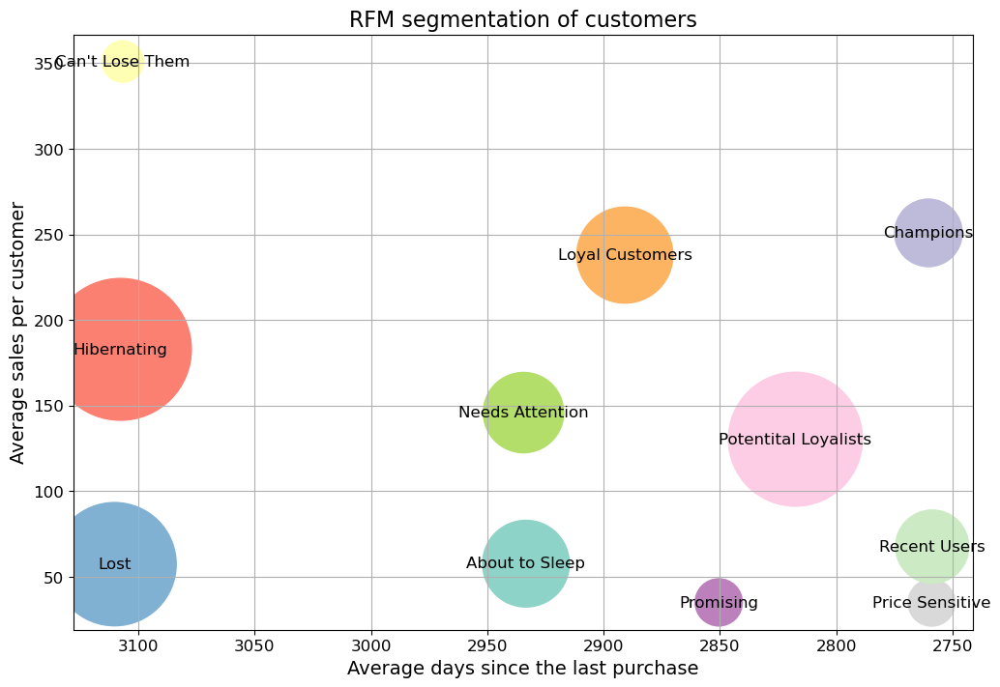

In [51]:
plt.figure(figsize=(12, 8))
scatter = plt.scatter(df['avg_days_since_purchase'], df['avg_sales_per_customer'],
    s=df['customer_count']*0.55, c=sns.color_palette('Set3', len(df)))
plt.xlabel('Average days since the last purchase', fontsize=14)
plt.ylabel('Average sales per customer', fontsize=14)
plt.title('RFM segmentation of customers')
plt.grid(True)
for i, text in enumerate(df['RFM_Bucket']):
    plt.annotate(text, (df['avg_days_since_purchase'][i], df['avg_sales_per_customer'][i]), 
        ha='center', va='center')
plt.gca().invert_xaxis()

plt.show()

In [52]:
repeat_customer_proportion = """
WITH CustomerOrder AS (
    SELECT 
        COUNT(olist_orders_dataset.order_id) as order_count
    FROM olist_orders_dataset
    JOIN olist_customers_dataset
    USING (customer_id)
    GROUP BY olist_customers_dataset.customer_unique_id)
SELECT
    CASE WHEN 
        order_count > 1 then 'repeat' else 'one-time' end as order_type,
    ROUND(100* COUNT(*)/(SELECT COUNT(*) FROM CustomerOrder),1) as proportion
FROM CustomerOrder
GROUP BY order_type
"""

df = pd.read_sql_query(repeat_customer_proportion,db_connection)
df

,order_type,proportion
0,one-time,96.0
1,repeat,3.0


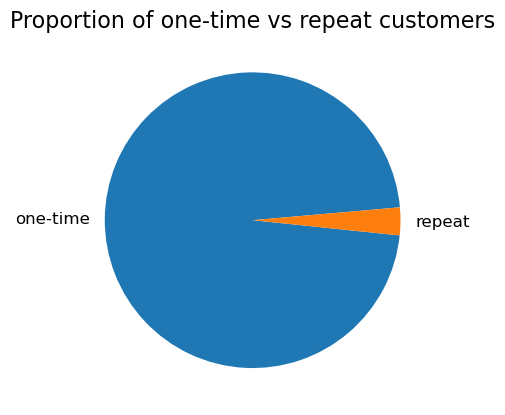

In [53]:
fig, ax = plt.subplots()
ax.pie(df['proportion'], labels=df['order_type'], startangle=5)
ax.set_title('Proportion of one-time vs repeat customers')
fig.set_facecolor('white')
plt.show()

# customer lifetime value

In [54]:
view_table('olist_order_payments_dataset',5)

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


In [55]:
clv = """
WITH CustomerDate AS (
    SELECT 
        customer_unique_id,
        customer_zip_code_prefix as zip_code_prefix,
        COUNT(DISTINCT olist_orders_dataset.order_id) AS order_count,
        SUM(payment_value) AS total_payment,
        JULIANDAY(MIN(order_purchase_timestamp)) AS first_order_day,
        JULIANDAY(MAX(order_purchase_timestamp)) AS last_order_day
    FROM olist_customers_dataset
    JOIN olist_orders_dataset USING (customer_id)
    JOIN olist_order_payments_dataset USING (order_id)
    GROUP BY customer_unique_id
    )
SELECT
    customer_unique_id,
    zip_code_prefix,
    order_count as PF,
    total_payment / order_count as AOV,
    CASE WHEN (last_order_day - first_order_day) < 7 THEN 1 ELSE
    (last_order_day - first_order_day)/7
END AS ACL
FROM CustomerDate
"""
df = pd.read_sql_query(clv,db_connection)
df

,customer_unique_id,zip_code_prefix,PF,AOV,ACL
0,0000366f3b9a7992bf8c76cfdf3221e2,7787,1,141.90,1.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,6053,1,27.19,1.0
2,0000f46a3911fa3c0805444483337064,88115,1,86.22,1.0
3,0000f6ccb0745a6a4b88665a16c9f078,66812,1,43.62,1.0
4,0004aac84e0df4da2b147fca70cf8255,18040,1,196.89,1.0
...,...,...,...,...,...
96090,fffcf5a5ff07b0908bd4e2dbc735a684,55250,1,2067.42,1.0
96091,fffea47cd6d3cc0a88bd621562a9d061,44054,1,84.58,1.0
96092,ffff371b4d645b6ecea244b27531430a,78552,1,112.46,1.0
96093,ffff5962728ec6157033ef9805bacc48,29460,1,133.69,1.0


In [56]:
avg_clv_per_zip_prefix = f"""
WITH CLV AS (
{clv})
SELECT
    zip_code_prefix as zip_prefix,
    avg(PF * AOV * ACL) AS avg_CLV,
    COUNT(customer_unique_id) as customer_count,
    geolocation_lat as latitude,
    geolocation_lng as longitude
FROM CLV
JOIN olist_geolocation_dataset ON CLV.zip_code_prefix = olist_geolocation_dataset.geolocation_zip_code_prefix
GROUP BY zip_code_prefix
"""
df = pd.read_sql_query(avg_clv_per_zip_prefix,db_connection)
df

,zip_prefix,avg_CLV,customer_count,latitude,longitude
0,1003,98.970000,17,-23.549032,-46.635313
1,1004,99.055000,44,-23.550116,-46.635122
2,1005,1082.762826,125,-23.549819,-46.635606
3,1006,434.025000,18,-23.550524,-46.636694
4,1007,126.387500,104,-23.550393,-46.637302
...,...,...,...,...,...
14821,99960,97.315000,10,-27.953797,-52.029641
14822,99965,113.795000,12,-28.173892,-52.038447
14823,99970,252.740000,21,-28.345143,-51.876926
14824,99980,111.385000,52,-28.389218,-51.846012


In [57]:
%pip install folium

Note: you may need to restart the kernel to use updated packages.


In [58]:
import folium

map = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)
for i, zip_prefix in df.iterrows():
    folium.CircleMarker(
        location=[zip_prefix['latitude'], zip_prefix['longitude']],
        radius=0.1*np.sqrt(zip_prefix['customer_count']),
        color=None,
        fill_color="#1249ae",
        fill_opacity=0.1+0.1*np.sqrt(zip_prefix['avg_CLV']/df['avg_CLV'].max()),
        popup=(
            f"<b>Zip Code Prefix:</b> {int(zip_prefix['zip_prefix'])}<br>"
            f"<b>Average CLV:</b> {int(zip_prefix['avg_CLV'])}<br>"
            f"<b>Customers:</b> {int(zip_prefix['customer_count'])}"
        )
    ).add_to(map)
map._repr_html_()

'<div style="width:100%;"><div style="position:relative;width:100%;height:0;padding-bottom:60%;"><span style="color:#565656">Make this Notebook Trusted to load map: File -> Trust Notebook</span><iframe srcdoc="&lt;!DOCTYPE html&gt;\n&lt;html&gt;\n&lt;head&gt;\n    \n    &lt;meta http-equiv=&quot;content-type&quot; content=&quot;text/html; charset=UTF-8&quot; /&gt;\n    &lt;script src=&quot;https://cdn.jsdelivr.net/npm/leaflet@1.9.3/dist/leaflet.js&quot;&gt;&lt;/script&gt;\n    &lt;script src=&quot;https://code.jquery.com/jquery-3.7.1.min.js&quot;&gt;&lt;/script&gt;\n    &lt;script src=&quot;https://cdn.jsdelivr.net/npm/bootstrap@5.2.2/dist/js/bootstrap.bundle.min.js&quot;&gt;&lt;/script&gt;\n    &lt;script src=&quot;https://cdnjs.cloudflare.com/ajax/libs/Leaflet.awesome-markers/2.0.2/leaflet.awesome-markers.js&quot;&gt;&lt;/script&gt;\n    &lt;link rel=&quot;stylesheet&quot; href=&quot;https://cdn.jsdelivr.net/npm/leaflet@1.9.3/dist/leaflet.css&quot;/&gt;\n    &lt;link rel=&quot;styles

# Product affinity

In [59]:
min_order = 5
most_order_products = f"""
SELECT
    olist_products_dataset.product_id,
    product_category_name_english as category,
    count(order_id) as orders_count
FROM olist_order_items_dataset
JOIN olist_products_dataset USING (product_id)
JOIN product_category_name_translation as tr
ON olist_products_dataset.product_category_name = tr.product_category_name
GROUP BY product_id, tr.product_category_name_english
HAVING COUNT(order_id) > {min_order}

"""

most_order_products_df = pd.read_sql_query(most_order_products,db_connection)
most_order_products_df

,product_id,category,orders_count
0,001795ec6f1b187d37335e1c4704762e,consoles_games,9
1,001b72dfd63e9833e8c02742adf472e3,furniture_decor,14
2,00210e41887c2a8ef9f791ebc780cc36,health_beauty,7
3,002159fe700ed3521f46cfcf6e941c76,fashion_shoes,8
4,00250175f79f584c14ab5cecd80553cd,housewares,11
...,...,...,...
3798,ffb97eb64c6fe1baada2410288c04457,perfumery,8
3799,ffc0b406806006602c5853b00ab5f7fd,christmas_supplies,6
3800,ffc9caf33e2d1e9f44e3e06da19085f7,health_beauty,27
3801,ffd4bf4306745865e5692f69bd237893,fashion_bags_accessories,8


In [60]:
most_ordered_product_ids = tuple(most_order_products_df['product_id'])

products_often_ordered_together = f"""
SELECT
    oi1.product_id as product_id1,
    oi2.product_id as product_id2,
    COUNT(DISTINCT oi1.order_id) as common_order_count
FROM olist_order_items_dataset AS oi1
JOIN olist_order_items_dataset AS oi2 ON oi1.order_id = oi2.order_id AND oi1.product_id < oi2.product_id
WHERE oi1.product_id IN {most_ordered_product_ids} AND 
oi2.product_id IN {most_ordered_product_ids}
GROUP BY 
    oi1.product_id,
    oi2.product_id
HAVING COUNT(DISTINCT oi1.order_id) > {min_order}

"""
products_often_ordered_together_df = pd.read_sql_query(products_often_ordered_together,db_connection)
products_often_ordered_together_df


,product_id1,product_id2,common_order_count
0,060cb19345d90064d1015407193c233d,98d61056e0568ba048e5d78038790e77,6
1,0bcc3eeca39e1064258aa1e932269894,422879e10f46682990de24d770e7f83d,6
2,0d85c435fd60b277ffb9e9b0f88f927a,ee57070aa3b24a06fdd0e02efd2d757d,6
3,18486698933fbb64af6c0a255f7dd64c,dbb67791e405873b259e4656bf971246,7
4,35afc973633aaeb6b877ff57b2793310,99a4788cb24856965c36a24e339b6058,29
5,368c6c730842d78016ad823897a372db,53759a2ecddad2bb87a079a1f1519f73,8
6,36f60d45225e60c7da4558b070ce4b60,3f14d740544f37ece8a9e7bc8349797e,12
7,36f60d45225e60c7da4558b070ce4b60,e53e557d5a159f5aa2c5e995dfdf244b,34
8,389d119b48cf3043d311335e499d9c6b,422879e10f46682990de24d770e7f83d,11
9,389d119b48cf3043d311335e499d9c6b,53759a2ecddad2bb87a079a1f1519f73,9


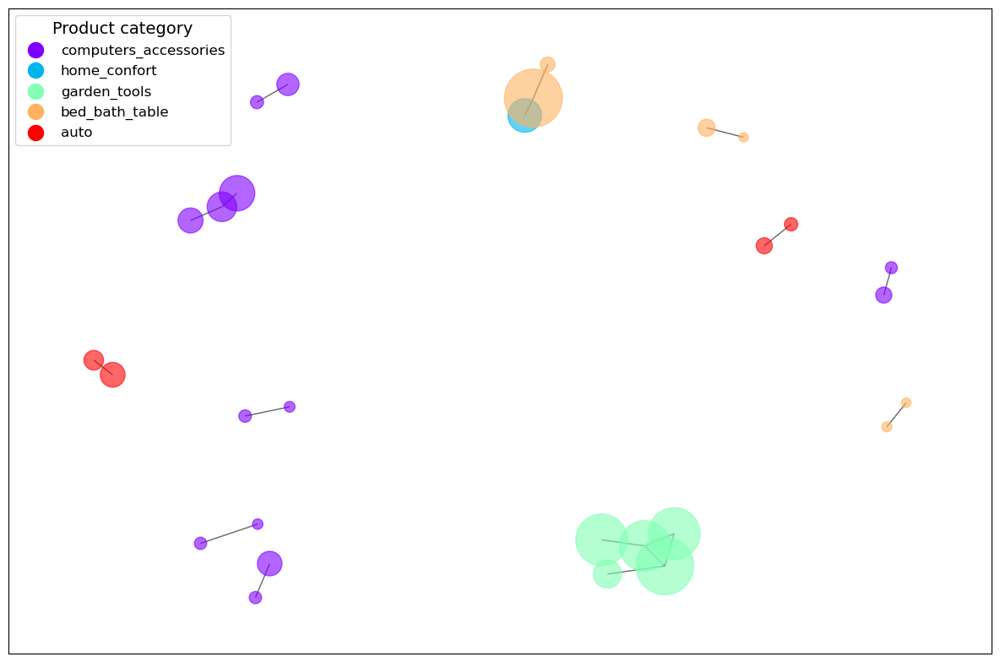

In [61]:
import networkx as nx

G = nx.Graph()
# Add nodes to the graph
for _, product in most_order_products_df.iterrows():
    G.add_node(product['product_id'], category=product['category'], orders_count=product['orders_count'])
# Add edges to the graph
for _, pair in products_often_ordered_together_df.iterrows():
    G.add_edge(pair['product_id1'], pair['product_id2'], weight=pair['common_order_count'])
# Remove nodes with no edges
G.remove_nodes_from(list(nx.isolates(G)))
# Assign colors to categories
categories = list(set(nx.get_node_attributes(G, 'category').values()))
colors = plt.cm.rainbow(np.linspace(0, 1, len(categories)))
category_colors = dict(zip(categories, colors))
# Draw the graph
plt.figure(figsize=(12, 8))
position = nx.spring_layout(G, k=0.5, iterations=50)
node_sizes = [G.nodes[n]['orders_count'] * 5 for n in G.nodes]
node_colors = [category_colors[G.nodes[n]['category']] for n in G.nodes]
nx.draw_networkx(G, position, node_color=node_colors, node_size=node_sizes, alpha=0.6, with_labels=False)
legend_elements = [plt.Line2D([0], [0], marker='o', color='w', label=category, markerfacecolor=color, markersize=15)
                   for category, color in category_colors.items()]
plt.legend(handles=legend_elements, title="Product category", loc='upper left', title_fontsize=14)
plt.tight_layout()
plt.show()

# sellers

In [62]:
view_table('olist_sellers_dataset',5)

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP


In [63]:
seller_review_scores_and_sales = """
SELECT 
    seller_id,
    AVG(olist_order_reviews_dataset.review_score) as avg_review_score,
    SUM(olist_order_items_dataset.price) as total_sales,
    COUNT(olist_orders_dataset.order_id) as total_orders
FROM olist_sellers_dataset
LEFT JOIN olist_order_items_dataset USING (seller_id)
LEFT JOIN olist_orders_dataset USING (order_id)
LEFT JOIN olist_order_reviews_dataset USING (order_id)
GROUP BY seller_id
HAVING COUNT(olist_orders_dataset.order_id) > 10
"""
df = pd.read_sql_query(seller_review_scores_and_sales, db_connection)
df

,seller_id,avg_review_score,total_sales,total_orders
0,001cca7ae9ae17fb1caed9dfb1094831,3.902542,25080.03,239
1,002100f778ceb8431b7a1020ff7ab48f,3.982143,1254.40,56
2,004c9cd9d87a3c30c522c48c4fc07416,4.132948,20467.18,176
3,00720abe85ba0859807595bbf045a33b,3.653846,1007.50,26
4,00ee68308b45bc5e2660cd833c3f81cc,4.331395,20345.00,173
...,...,...,...,...
1310,ffc470761de7d0232558ba5e786e57b7,4.300000,1649.01,31
1311,ffdd9f82b9a447f6f8d4b91554cc7dd3,4.250000,2101.20,20
1312,ffeee66ac5d5a62fe688b9d26f83f534,4.214286,1839.86,14
1313,fffd5413c0700ac820c7069d66d98c89,3.866667,9062.30,61


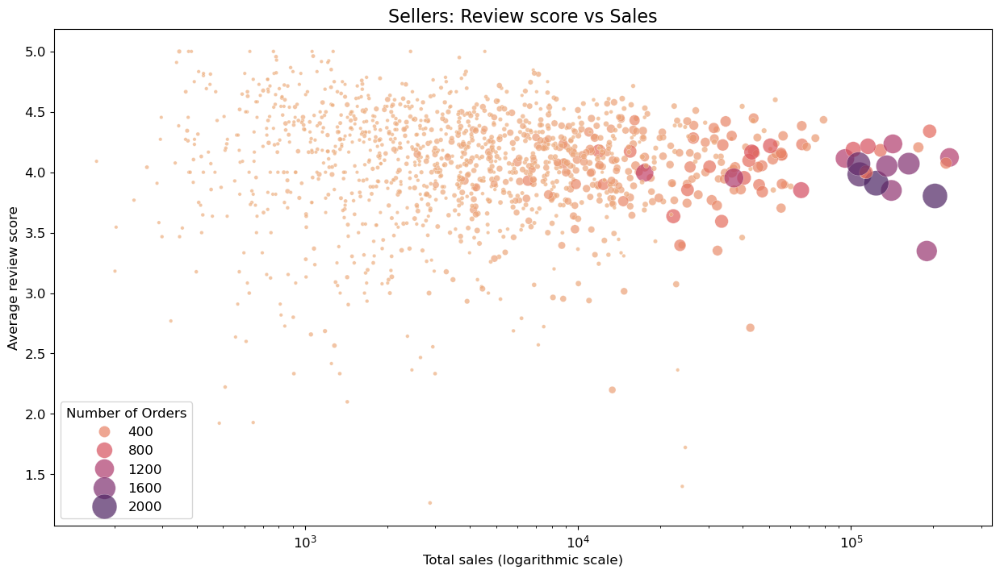

In [64]:
plt.figure(figsize=(15, 8))
sns.scatterplot(data=df, x='total_sales', y='avg_review_score', size='total_orders', sizes=(10, 500), 
                hue='total_orders', palette='flare', alpha=0.7)
plt.xscale('log')
plt.xlabel('Total sales (logarithmic scale)')
plt.ylabel('Average review score')
plt.title('Sellers: Review score vs Sales')
plt.legend(title='Number of Orders')
plt.show()

In [65]:
bucketed_sellers = """
SELECT
    seller_id,
    CASE
        WHEN COUNT(order_id) BETWEEN 1 AND 9 THEN '1-9 orders'
        WHEN COUNT(order_id) BETWEEN 10 AND 99 THEN '10-99 orders'
        WHEN COUNT(order_id) BETWEEN 100 AND 999 THEN '100-999 orders'
        ELSE '1000+ orders'
    END AS bucket
FROM olist_order_items_dataset
GROUP BY seller_id

"""
df = pd.read_sql_query(bucketed_sellers, db_connection)
df

,seller_id,bucket
0,0015a82c2db000af6aaaf3ae2ecb0532,1-9 orders
1,001cca7ae9ae17fb1caed9dfb1094831,100-999 orders
2,001e6ad469a905060d959994f1b41e4f,1-9 orders
3,002100f778ceb8431b7a1020ff7ab48f,10-99 orders
4,003554e2dce176b5555353e4f3555ac8,1-9 orders
...,...,...
3090,ffcfefa19b08742c5d315f2791395ee5,1-9 orders
3091,ffdd9f82b9a447f6f8d4b91554cc7dd3,10-99 orders
3092,ffeee66ac5d5a62fe688b9d26f83f534,10-99 orders
3093,fffd5413c0700ac820c7069d66d98c89,10-99 orders


In [66]:
seller_per_bucket = F"""
WITH BucketedSellers AS (
{bucketed_sellers})
SELECT
    bucket,
    COUNT(*) AS seller_count
FROM BucketedSellers
GROUP BY bucket
"""
df = pd.read_sql_query(seller_per_bucket, db_connection)
df

,bucket,seller_count
0,1-9 orders,1714
1,10-99 orders,1142
2,100-999 orders,226
3,1000+ orders,13


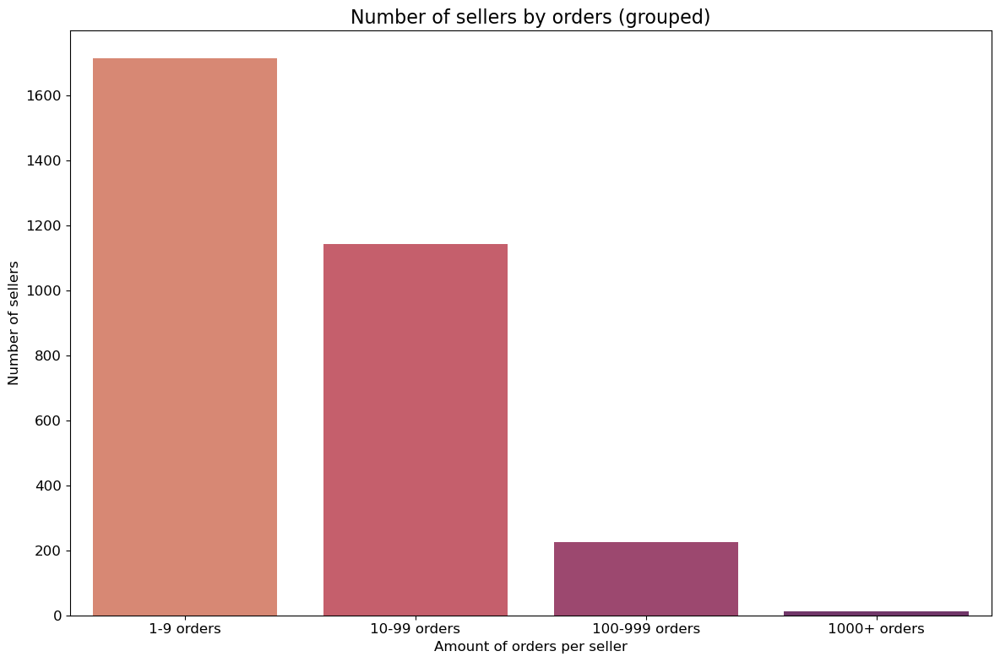

In [67]:
plt.figure(figsize=(12, 8))
sns.barplot(x='bucket', y='seller_count', data=df, hue='bucket', palette='flare', dodge=False)
plt.title('Number of sellers by orders (grouped)')
plt.xlabel('Amount of orders per seller')
plt.ylabel('Number of sellers')
plt.tight_layout()
plt.show()

In [68]:
seller_shipping_times = f"""
WITH BucketedSellers AS (
{bucketed_sellers})
SELECT
    bucket,
    seller_id,
    JULIANDAY(order_delivered_customer_date) - JULIANDAY(order_purchase_timestamp) AS delivery_time
FROM olist_orders_dataset
JOIN olist_order_items_dataset USING (order_id)
JOIN BucketedSellers USING (seller_id)
WHERE order_status = 'delivered'
"""
df = pd.read_sql_query(seller_shipping_times, db_connection)
df

,bucket,seller_id,delivery_time
0,10-99 orders,3504c0cb71d7fa48d967e0e4c94d59d9,8.436574
1,100-999 orders,289cdb325fb7e7f891c38608bf9e0962,13.782037
2,1000+ orders,4869f7a5dfa277a7dca6462dcf3b52b2,9.394213
3,100-999 orders,66922902710d126a0e7d26b0e3805106,13.208750
4,100-999 orders,2c9e548be18521d1c43cde1c582c6de8,2.873877
...,...,...,...
110192,10-99 orders,1f9ab4708f3056ede07124aad39a2554,22.193727
110193,10-99 orders,d50d79cb34e38265a8649c383dcffd48,24.859421
110194,100-999 orders,a1043bafd471dff536d0c462352beb48,17.086424
110195,100-999 orders,a1043bafd471dff536d0c462352beb48,17.086424


C:\Users\23304\AppData\Local\Temp\ipykernel_369944\616681445.py:8: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().remove()


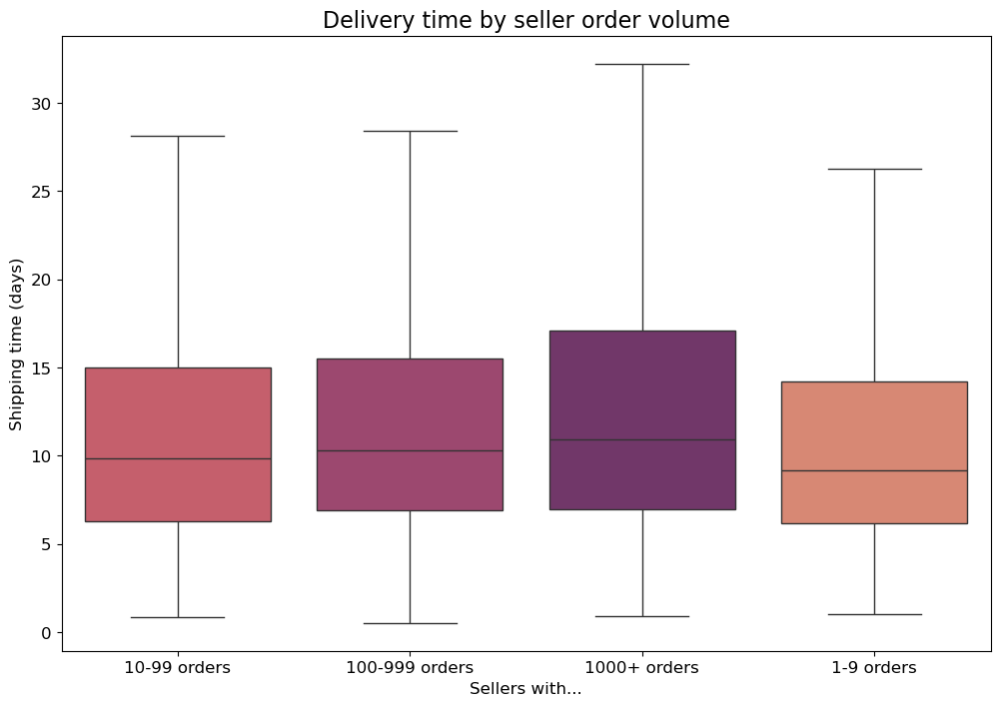

In [69]:
plt.figure(figsize=(12, 8))
palette = sns.color_palette('flare', len(df['bucket'].unique()))
sns.boxplot(x='bucket', y='delivery_time', data=df, order=df['bucket'], showfliers=False,
            hue='bucket', palette=palette[1:]+palette[:1], dodge=False)
plt.title('Delivery time by seller order volume')
plt.xlabel('Sellers with...')
plt.ylabel('Shipping time (days)')
plt.legend().remove() 
plt.show()

# market funnel

In [70]:
view_table('olist_marketing_qualified_leads_dataset',5)

,mql_id,first_contact_date,landing_page_id,origin
0,dac32acd4db4c29c230538b72f8dd87d,2018-02-01,88740e65d5d6b056e0cda098e1ea6313,social
1,8c18d1de7f67e60dbd64e3c07d7e9d5d,2017-10-20,007f9098284a86ee80ddeb25d53e0af8,paid_search
2,b4bc852d233dfefc5131f593b538befa,2018-03-22,a7982125ff7aa3b2054c6e44f9d28522,organic_search
3,6be030b81c75970747525b843c1ef4f8,2018-01-22,d45d558f0daeecf3cccdffe3c59684aa,email
4,5420aad7fec3549a85876ba1c529bd84,2018-02-21,b48ec5f3b04e9068441002a19df93c6c,organic_search


In [71]:
view_table('olist_closed_deals_dataset',5).iloc[:,[0,3,4,5]]

,mql_id,sr_id,won_date,business_segment
0,5420aad7fec3549a85876ba1c529bd84,4ef15afb4b2723d8f3d81e51ec7afefe,2018-02-26 19:58:54,pet
1,a555fb36b9368110ede0f043dfc3b9a0,d3d1e91a157ea7f90548eef82f1955e3,2018-05-08 20:17:59,car_accessories
2,327174d3648a2d047e8940d7d15204ca,6565aa9ce3178a5caf6171827af3a9ba,2018-06-05 17:27:23,home_appliances
3,f5fee8f7da74f4887f5bcae2bafb6dd6,d3d1e91a157ea7f90548eef82f1955e3,2018-01-17 13:51:03,food_drink
4,ffe640179b554e295c167a2f6be528e0,d3d1e91a157ea7f90548eef82f1955e3,2018-07-03 20:17:45,home_appliances


In [72]:
lead_conversion = """
SELECT 
    COALESCE(origin, 'unknown') as origin,
    COUNT(DISTINCT olist_marketing_qualified_leads_dataset.mql_id) as qualified_leads,
    COUNT(DISTINCT olist_closed_deals_dataset.mql_id) as closed_deals,
    COUNT(DISTINCT olist_closed_deals_dataset.mql_id) * 100.0 / 
    COUNT(DISTINCT olist_marketing_qualified_leads_dataset.mql_id) as conversion_rate
FROM olist_marketing_qualified_leads_dataset
LEFT JOIN olist_closed_deals_dataset USING (mql_id)
GROUP BY COALESCE(origin, 'unknown')
ORDER BY COUNT(DISTINCT olist_marketing_qualified_leads_dataset.mql_id) DESC
"""

df = pd.read_sql_query(lead_conversion, db_connection)
df

,origin,qualified_leads,closed_deals,conversion_rate
0,organic_search,2296,271,11.803136
1,paid_search,1586,195,12.295082
2,social,1350,75,5.555556
3,unknown,1159,193,16.652286
4,direct_traffic,499,56,11.222445
5,email,493,15,3.042596
6,referral,284,24,8.450704
7,other,150,4,2.666667
8,display,118,6,5.084746
9,other_publicities,65,3,4.615385


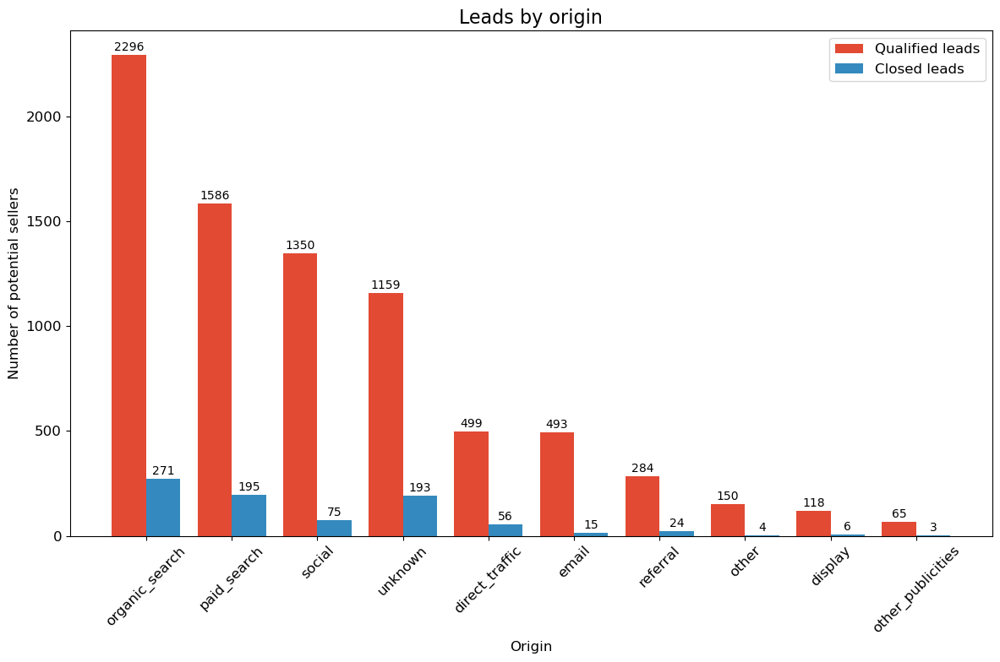

In [73]:
plt.figure(figsize=(12, 8))
bar_width = 0.4
r1 = range(len(df))
r2 = [x + bar_width for x in r1]
plt.bar(r1, df['qualified_leads'], color='#e24a33', width=bar_width, label='Qualified leads')
plt.bar(r2, df['closed_deals'], color='#348abe', width=bar_width, label='Closed leads')
for i, v in enumerate(df['qualified_leads']):
    plt.text(i, v + 20, str(v), ha='center', fontsize=10)
for i, v in enumerate(df['closed_deals']):
    plt.text(i + bar_width, v + 20, str(v), ha='center', fontsize=10)
plt.xlabel('Origin')
plt.ylabel('Number of potential sellers')
plt.title('Leads by origin')
plt.xticks([r + bar_width / 2 for r in range(len(df))], df['origin'],
           rotation=45, color='black', fontsize=12)
plt.legend(fontsize=12)
plt.tight_layout()
plt.show()

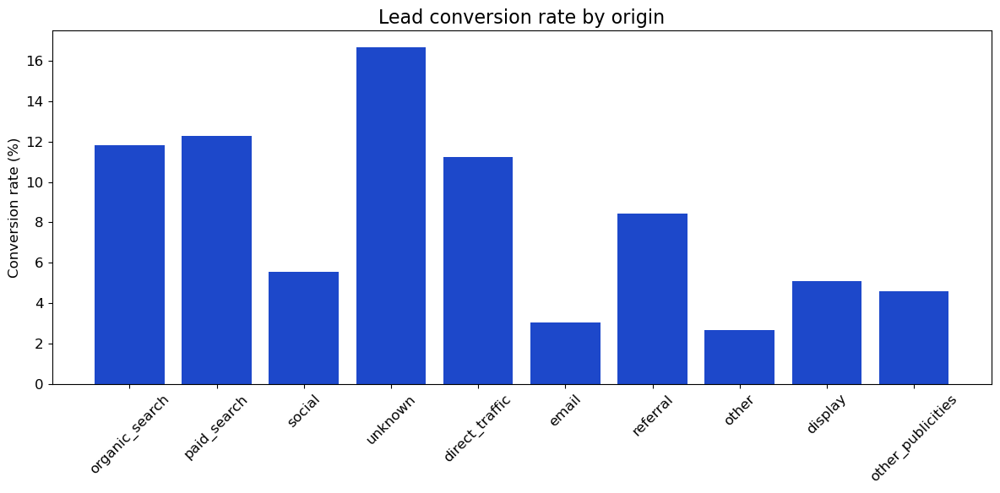

In [74]:
plt.figure(figsize=(12, 6))
plt.bar(df['origin'], df['conversion_rate'], color="#1d48ca")
plt.ylabel('Conversion rate (%)')
plt.title('Lead conversion rate by origin')
plt.xticks(rotation=45, color='black', fontsize=12)
plt.tight_layout()
plt.show()

# new user'GMV VS previous users' GMV

In [75]:
import pandas as pd

GMV_comparsion = """

WITH RawData AS (
    SELECT 
        o.order_id,
        c.customer_unique_id,
        o.order_purchase_timestamp,
        oi.price,
    ROW_NUMBER() OVER (PARTITION BY c.customer_unique_id ORDER BY o.order_purchase_timestamp) AS order_number
    FROM olist_orders_dataset o
    JOIN olist_customers_dataset c ON o.customer_id = c.customer_id
    JOIN olist_order_items_dataset oi ON o.order_id = oi.order_id
    WHERE o.order_status = 'delivered'
),
MonthlyStats AS (
    SELECT
        STRFTIME('%Y-%m', order_purchase_timestamp) AS order_month,
        price,
        CASE 
            WHEN order_number = 1 THEN 'first_order' 
            ELSE 'repeat_order' 
        END AS user_type
    FROM RawData)

    SELECT
        order_month,
    ROUND(SUM(CASE WHEN user_type = 'first_order' THEN price ELSE 0 END), 2) AS first_order_GMV,
    ROUND(SUM(CASE WHEN user_type = 'repeat_order' THEN price ELSE 0 END), 2) AS repeat_order_GMV,
    ROUND(
        SUM(CASE WHEN user_type = 'repeat_order' THEN price ELSE 0 END) * 100.0 / SUM(price), 
        2
    ) as retention_gmv_rate
FROM MonthlyStats
GROUP BY order_month
ORDER BY order_month

"""

df = pd.read_sql_query(GMV_comparsion, db_connection)
df

,order_month,first_order_GMV,repeat_order_GMV,retention_gmv_rate
0,2016-09,44.99,89.98,66.67
1,2016-10,36089.91,4235.20,10.50
2,2016-12,10.90,0.00,0.00
3,2017-01,98071.23,13727.13,12.28
4,2017-02,214449.90,19773.50,8.44
5,2017-03,327777.64,31421.21,8.75
6,2017-04,311424.14,29245.54,8.58
7,2017-05,436406.35,52931.90,10.82
8,2017-06,384426.42,37496.95,8.89
9,2017-07,423901.40,57703.12,11.98


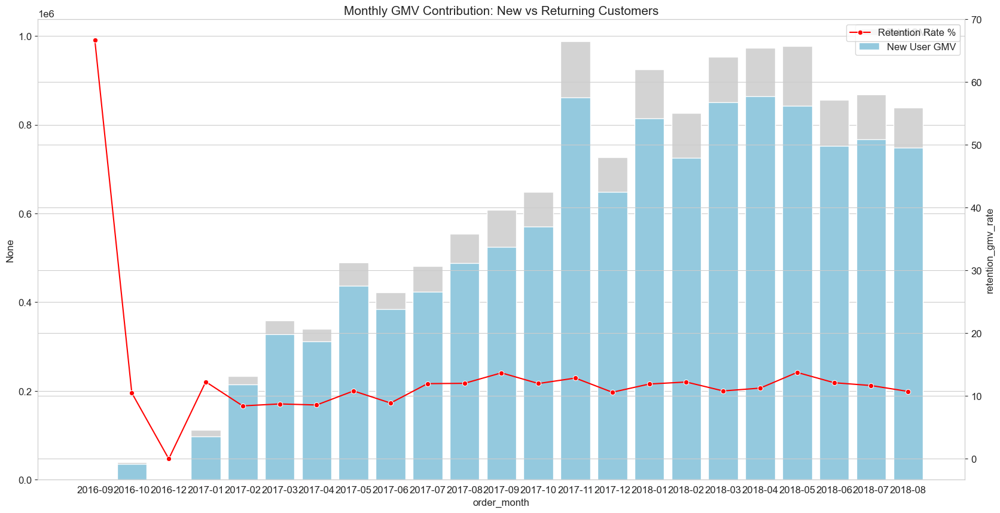

In [76]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(20, 10))
sns.set_style("whitegrid")


sns.barplot(data=df, x='order_month', y=df['first_order_GMV'] + df['repeat_order_GMV'], 
            color='lightgray', label='Total GMV')


sns.barplot(data=df, x='order_month', y='first_order_GMV', 
            color='skyblue', label='New User GMV')


ax2 = plt.twinx()
sns.lineplot(data=df, x='order_month', y='retention_gmv_rate', 
             color='red', marker='o', ax=ax2, label='Retention Rate %')

plt.title('Monthly GMV Contribution: New vs Returning Customers', fontsize=15)
plt.xticks(rotation=45)
plt.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.show()

# 80% GMV category

In [77]:
Category_Concentration = """
WITH CategoryGMV AS (
    SELECT 
        COALESCE(product_category_name_translation.product_category_name_english, 'others') AS category,
        SUM(OI.price) AS total_revenue
    FROM olist_order_items_dataset oi
    JOIN olist_products_dataset USING (product_id)
    JOIN product_category_name_translation USING (product_category_name)
    GROUP BY 1
),
RankedCategory as (
    SELECT
        category,
        total_revenue,
        SUM(total_revenue) OVER (ORDER BY total_revenue DESC) AS cumulative_revenue,
        SUM(total_revenue) OVER () AS overall_revenue
    FROM CategoryGMV
)
SELECT
    category,
    total_revenue,
    ROUND(cumulative_revenue * 100.0 / overall_revenue, 2) AS cumulative_revenue_percentage
FROM RankedCategory
ORDER BY total_revenue DESC
"""

df = pd.read_sql_query(Category_Concentration, db_connection)
df

,category,total_revenue,cumulative_revenue_percentage
0,health_beauty,1258681.34,9.39
1,watches_gifts,1205005.68,18.38
2,bed_bath_table,1036988.68,26.11
3,sports_leisure,988048.97,33.48
4,computers_accessories,911954.32,40.28
...,...,...,...
66,flowers,1110.04,99.98
67,home_comfort_2,760.27,99.99
68,cds_dvds_musicals,730.00,99.99
69,fashion_childrens_clothes,569.85,100.00


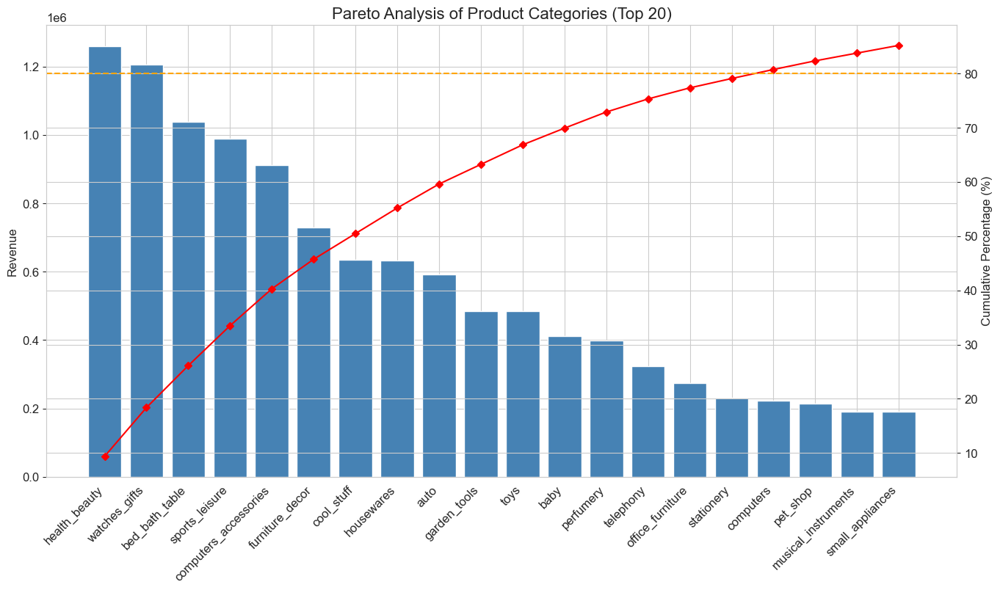

In [78]:

import matplotlib.pyplot as plt

df['cumulative_revenue_percentage'] = df['total_revenue'].cumsum() / df['total_revenue'].sum() * 100

fig, ax1 = plt.subplots(figsize=(16, 8))


top_df = df.head(20)
ax1.bar(top_df['category'], top_df['total_revenue'], color='steelblue')
ax1.set_ylabel('Revenue', fontsize=12)
plt.xticks(rotation=45, ha='right')

ax2 = ax1.twinx()
ax2.plot(top_df['category'], top_df['cumulative_revenue_percentage'], color='red', marker='D', ms=5)
ax2.axhline(80, color='orange', linestyle='--', label='80% Threshold') # 80% threshold line
ax2.set_ylabel('Cumulative Percentage (%)', fontsize=12)

plt.title('Pareto Analysis of Product Categories (Top 20)', fontsize=16)
plt.show()

# conclusion

## The analysis reveals a significant Pareto effect within the platform's revenue structure, where approximately 20% of product categories, such as health and beauty, watches and gifts, and bed and bath table items, contribute to 80% of the total revenue. 
## Geographically, the customer base is heavily concentrated in the Southeast region, particularly in Sao Paulo. While most orders are successfully delivered, there is a clear correlation between lower review scores and logistical delays, indicating that shipping performance is a primary driver of customer satisfaction. Furthermore, the data shows that most customers are one-time purchasers, and certain products are frequently ordered together, highlighting opportunities for improved retention and basket size.

## To drive business growth, the company should implement a tiered inventory management strategy that prioritizes high-performing categories to ensure stock availability for the top revenue-drivers. Establishing regional distribution centers near high-demand hubs like Sao Paulo could significantly reduce transit times and improve review scores. 
## Additionally, the company should leverage the identified product associations to create cross-selling bundles (like Health & Beauty and Bed & Bath) as "anchor products" to be bundled with higher-margin accessories from a single top-rated seller, ensuring both increased revenue and streamlined delivery. And introduce a loyalty program to encourage repeat purchases from the existing customer base. Proactive customer service interventions for delayed shipments can also help mitigate negative feedback and enhance the overall brand reputation.